# Rt profile multicategorical versus uniform

In [1]:
# Import libraries
import numpy as np
import math
import branchpro
import scipy.stats
from branchpro.apps import ReproductionNumberPlot
import matplotlib.pyplot as plt
import plotly.graph_objects as go
import pandas as pd
from cmdstanpy import CmdStanModel, cmdstan_path
import arviz as az
import nest_asyncio
import seaborn as sns
nest_asyncio.apply()

num_timepoints = 100 # number of days for incidence data
num_categories = 2

/Users/ioaros/opt/anaconda3/envs/testbranchpro2/lib/python3.10/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [2]:
# # Read contact matrix
# cm_file = 'UK'
# path = os.path.join('../data_library/contact_matrix', '{}.csv'.format(cm_file))
# contact_matrix = pd.read_csv(path, header=None)

# # Read serial interval
# si_file = 'si-epinow'
# path = os.path.join('../data_library/serial_interval', '{}.csv'.format(si_file))
# serial_interval = pd.read_csv(path, header=None)
# serial_interval = serial_interval.fillna(0)
# serial_intervals = serial_interval.values.T

# # Read transmissibility vector
# trans_file = 'UK'
# path = os.path.join('../data_library/transmissibility', '{}.csv'.format(trans_file))
# transmissibility = pd.read_csv(path, header=None)

In [3]:
# # Read Ontario data
# path = os.path.join('../data_library/covid_ontario/ON.csv')
# data = pd.read_csv(path)[:51]

## Parameterize example branching process model with disagregated data

In [4]:
# Build the serial interval w_s
ws_mean = 15.3
ws_var = 9.3**2
theta = ws_var / ws_mean
k = ws_mean / theta
w_dist = scipy.stats.gamma(k, scale=theta)
disc_w = w_dist.pdf(np.arange(num_timepoints))

# Simulate incidence data
initial_r = 1.2
serial_interval = disc_w

# contact_matrix = contact_matrix
contact_matrix = np.array([[8., 4.8], [1.2, 3.84]])
# contact_matrix = 1 * np.ones((2, 2))

transmissibility = [1, 0.5]
# transmissibility = [1.5, 1.5]

m = branchpro.MultiCatPoissonBranchProModel(
    initial_r, serial_interval, num_categories, contact_matrix, transmissibility)
new_rs = [0.5, 0.05, 0.2]          # sequence of R_0 numbers
start_times = [0, 30, 60]      # days at which each R_0 period begins
m.set_r_profile(new_rs, start_times)
parameters = [200, 20] # initial number of cases
times = np.arange(num_timepoints)

desagg_cases = m.simulate(parameters, times, var_contacts=True)
agg_cases = np.sum(desagg_cases, axis=1)

print(desagg_cases)

[[2.000e+02 2.000e+01]
 [0.000e+00 0.000e+00]
 [6.000e+00 0.000e+00]
 [1.000e+01 1.000e+00]
 [3.700e+01 5.000e+00]
 [4.200e+01 8.000e+00]
 [4.700e+01 4.000e+00]
 [4.400e+01 4.000e+00]
 [6.400e+01 0.000e+00]
 [5.200e+01 0.000e+00]
 [3.900e+01 1.700e+01]
 [5.800e+01 9.000e+00]
 [1.040e+02 0.000e+00]
 [1.060e+02 3.000e+00]
 [1.040e+02 1.000e+00]
 [1.460e+02 1.400e+01]
 [1.480e+02 2.800e+01]
 [8.400e+01 2.100e+01]
 [1.340e+02 4.300e+01]
 [1.880e+02 2.800e+01]
 [2.580e+02 3.400e+01]
 [1.050e+02 4.000e+00]
 [3.650e+02 2.700e+01]
 [4.630e+02 4.000e+00]
 [3.810e+02 8.000e+01]
 [3.220e+02 1.040e+02]
 [2.440e+02 1.240e+02]
 [7.420e+02 1.190e+02]
 [3.660e+02 2.020e+02]
 [4.990e+02 2.300e+01]
 [1.047e+03 9.900e+01]
 [3.300e+01 1.000e+01]
 [5.500e+01 2.100e+01]
 [1.130e+02 3.000e+01]
 [7.800e+01 1.300e+01]
 [1.100e+02 4.900e+01]
 [1.540e+02 2.400e+01]
 [7.700e+01 1.600e+01]
 [4.800e+01 4.000e+01]
 [1.160e+02 1.000e+00]
 [1.310e+02 2.300e+01]
 [9.700e+01 2.000e+01]
 [4.200e+01 1.400e+01]
 [9.000e+01

## Plot agreggated local incidence numbers

In [5]:
# Plot (bar chart cases each day)
fig = go.Figure()

# Plot of incidences
fig.add_trace(
    go.Bar(
        x=times,
        y=agg_cases,
        name='Incidences'
    )
)

# Add axis labels
fig.update_layout(
    xaxis_title='Time (days)',
    yaxis_title='New cases'
)

fig.show()

## R_t inference using STAN

In [6]:
# Same inference, but using the PoissonBranchProPosterior
tau = 6
R_t_start = tau+1
a = 1
b = 1/5
sigma = 1.5

# Correction for reproduction number per category
correc_i = np.multiply(np.sum(contact_matrix, axis=0), transmissibility)
correc_e = np.multiply(np.sum(m.exact_contact_matrix, axis=1), transmissibility)

In [7]:
# Transform our incidence data into pandas dataframes
multicat_inc_data_matrix = {'Time': np.arange(num_timepoints)}

for _ in range(num_categories):
    multicat_inc_data_matrix['Incidence Number Cat {}'.format(_+1)] = \
        desagg_cases[:, _]

multicat_inc_data = pd.DataFrame(multicat_inc_data_matrix)

# Transform our incidence data into pandas dataframes
inc_data = pd.DataFrame(
    {
        'Time': np.arange(num_timepoints),
        'Incidence Number': agg_cases
    }
)

L1 = len(np.arange(R_t_start, start_times[1]+1))
L2 = len(np.arange(start_times[1]+1, start_times[2]+1))
L3 = len(np.arange(start_times[2]+1, num_timepoints))

ground_truth = []
for j in range(num_categories):
    ground_truth.append(pd.DataFrame({
        'Time Points': np.arange(R_t_start, num_timepoints),
        'R_t': (0.5*correc_e[R_t_start:(start_times[1]+1), j]).tolist() + (0.05*correc_e[(start_times[1]+1):(start_times[2]+1), j]).tolist() + (0.2*correc_e[(start_times[2]+1):num_timepoints, j]).tolist()
    }))

## 1. Exact Contact data + Group-specific cases + Poisson Branching process with multiple categories

In [8]:
exact_multicat_model = CmdStanModel(stan_file=os.path.join(
        '../../stan_models/exact_multicat.stan'))

exact_multicat_data = {
    'N': num_timepoints,
    'S': len(serial_interval),
    'n': num_categories,
    'C': np.array(m.exact_contact_matrix),
    'transm': transmissibility,
    'I': desagg_cases.astype(np.integer).tolist(),
    'tau': tau,
    'revSI': serial_interval.tolist()[::-1],
    'a': a,
    'b': b,
    'sigma': sigma}

/var/folders/ph/jyxnc9y52svgq2k5lt2q4r000000gp/T/ipykernel_27881/3829575306.py:10: DeprecationWarning:

Converting `np.integer` or `np.signedinteger` to a dtype is deprecated. The current result is `np.dtype(np.int_)` which is not strictly correct. Note that the result depends on the system. To ensure stable results use may want to use `np.int64` or `np.int32`.



In [9]:
fit = exact_multicat_model.sample(
    data=exact_multicat_data, seed=10, chains=3, iter_sampling=1000)

samples = az.from_cmdstanpy(fit)

az.summary(samples)

11:43:51 - cmdstanpy - INFO - CmdStan start processing
chain 1 |          | 00:00 Status

chain 1 |▍         | 00:00 Status
chain 1 |▉         | 01:10 Iteration:    1 / 2000 [  0%]  (Warmup)
chain 1 |█▎        | 02:02 Iteration:  100 / 2000 [  5%]  (Warmup)
chain 1 |█▊        | 02:48 Iteration:  200 / 2000 [ 10%]  (Warmup)
chain 1 |██▎       | 03:30 Iteration:  300 / 2000 [ 15%]  (Warmup)
chain 1 |██▋       | 04:13 Iteration:  400 / 2000 [ 20%]  (Warmup)
chain 1 |███▏      | 04:53 Iteration:  500 / 2000 [ 25%]  (Warmup)
chain 1 |███▋      | 05:31 Iteration:  600 / 2000 [ 30%]  (Warmup)
chain 1 |████      | 06:07 Iteration:  700 / 2000 [ 35%]  (Warmup)
chain 1 |████▌     | 06:43 Iteration:  800 / 2000 [ 40%]  (Warmup)

chain 1 |█████▉    | 07:57 Iteration: 1001 / 2000 [ 50%]  (Sampling)
chain 1 |██████▎   | 08:29 Iteration: 1100 / 2000 [ 55%]  (Sampling)
chain 1 |██████▊   | 09:00 Iteration: 1200 / 2000 [ 60%]  (Sampling)
chain 1 |███████▎  | 09:32 Iteration: 1300 / 2000 [ 65%]  (Sampli


11:57:50 - cmdstanpy - INFO - CmdStan done processing.
11:57:50 - cmdstanpy - WARNING - Non-fatal error during sampling:
Exception: gamma_lpdf: Random variable is 0, but must be positive finite! (in 'exact_multicat.stan', line 55, column 8 to column 28)
	Exception: gamma_lpdf: Random variable is 0, but must be positive finite! (in 'exact_multicat.stan', line 55, column 8 to column 28)
	Exception: gamma_lpdf: Random variable is 0, but must be positive finite! (in 'exact_multicat.stan', line 55, column 8 to column 28)
	Exception: gamma_lpdf: Random variable is 0, but must be positive finite! (in 'exact_multicat.stan', line 55, column 8 to column 28)
	Exception: gamma_lpdf: Random variable is 0, but must be positive finite! (in 'exact_multicat.stan', line 55, column 8 to column 28)
	Exception: gamma_lpdf: Random variable is 0, but must be positive finite! (in 'exact_multicat.stan', line 55, column 8 to column 28)
Exception: gamma_lpdf: Random variable is 0, but must be positive finite! (

,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_bulk,ess_tail,r_hat
R[0],0.545,0.039,0.468,0.615,0.001,0.0,4028.0,2027.0,1.0
R[1],0.514,0.032,0.455,0.575,0.000,0.0,4336.0,2295.0,1.0
R[2],0.510,0.029,0.458,0.565,0.000,0.0,3981.0,1898.0,1.0
R[3],0.509,0.027,0.459,0.558,0.000,0.0,3488.0,2163.0,1.0
R[4],0.501,0.026,0.450,0.549,0.000,0.0,4090.0,1780.0,1.0
...,...,...,...,...,...,...,...,...,...
R[88],0.198,0.004,0.192,0.205,0.000,0.0,5304.0,1826.0,1.0
R[89],0.199,0.003,0.192,0.205,0.000,0.0,4134.0,2474.0,1.0
R[90],0.201,0.004,0.194,0.208,0.000,0.0,3911.0,2094.0,1.0
R[91],0.201,0.004,0.194,0.209,0.000,0.0,4121.0,2278.0,1.0


array([[<Axes: title={'center': 'R\n0'}>,
        <Axes: title={'center': 'R\n0'}>],
       [<Axes: title={'center': 'R\n1'}>,
        <Axes: title={'center': 'R\n1'}>],
       [<Axes: title={'center': 'R\n2'}>,
        <Axes: title={'center': 'R\n2'}>],
       [<Axes: title={'center': 'R\n3'}>,
        <Axes: title={'center': 'R\n3'}>],
       [<Axes: title={'center': 'R\n4'}>,
        <Axes: title={'center': 'R\n4'}>],
       [<Axes: title={'center': 'R\n5'}>,
        <Axes: title={'center': 'R\n5'}>],
       [<Axes: title={'center': 'R\n6'}>,
        <Axes: title={'center': 'R\n6'}>],
       [<Axes: title={'center': 'R\n7'}>,
        <Axes: title={'center': 'R\n7'}>],
       [<Axes: title={'center': 'R\n8'}>,
        <Axes: title={'center': 'R\n8'}>],
       [<Axes: title={'center': 'R\n9'}>,
        <Axes: title={'center': 'R\n9'}>],
       [<Axes: title={'center': 'R\n10'}>,
        <Axes: title={'center': 'R\n10'}>],
       [<Axes: title={'center': 'R\n11'}>,
        <Axes: title

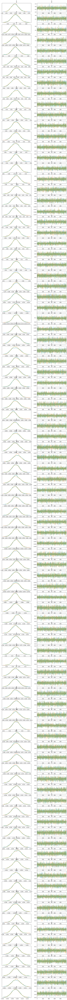

In [10]:
az.rcParams['plot.max_subplots'] = 2*(num_timepoints - R_t_start)

az.plot_trace(
    samples,
    var_names=('R'),
    filter_vars='like',
    compact=False)

In [11]:
# Eliminate burn-in iterations (1/2 of the chain lengths)
chain_samples = fit.draws()[500:, :, 7:]

# Evaluate the model for all parameter sets in the samples
n_param, n_sample, n_chains = chain_samples.shape

extended_samples = np.concatenate((
    chain_samples[:, 0, :],
    chain_samples[:, 1, :],
    chain_samples[:, 2, :]), axis=0)

thinning = max(1, int(n_sample * n_chains / 500))
exact_multicat_intervals = []

for j in range(num_categories):
    exact_multicat_intervals.append(pd.DataFrame({
        'Time Points': np.arange(R_t_start, num_timepoints),
        'Mean': np.mean(extended_samples[::thinning, :] * correc_e[R_t_start:, j][None, :], axis=0),
        'Lower bound CI': np.quantile(extended_samples[::thinning, :] * correc_e[R_t_start:, j][None, :], 0.025, axis=0),
        'Upper bound CI': np.quantile(extended_samples[::thinning, :] * correc_e[R_t_start:, j][None, :], 0.975, axis=0),
        'Central Probability': (L1+L2+L3) * [0.95]
    }))

## 2. Average Contact data + Group-specific cases + Poisson Branching process with multiple categories

In [12]:
approx_multicat_model = CmdStanModel(stan_file=os.path.join(
        '../../stan_models/approx_multicat.stan'))

approx_multicat_data = {
    'N': num_timepoints,
    'S': len(serial_interval),
    'n': num_categories,
    'C': contact_matrix,
    'transm': transmissibility,
    'I': desagg_cases.astype(np.integer).tolist(),
    'tau': tau,
    'revSI': serial_interval.tolist()[::-1],
    'a': a,
    'b': b,
    'sigma': sigma}

/var/folders/ph/jyxnc9y52svgq2k5lt2q4r000000gp/T/ipykernel_27881/2726440678.py:10: DeprecationWarning:

Converting `np.integer` or `np.signedinteger` to a dtype is deprecated. The current result is `np.dtype(np.int_)` which is not strictly correct. Note that the result depends on the system. To ensure stable results use may want to use `np.int64` or `np.int32`.



In [13]:
fit = approx_multicat_model.sample(data=approx_multicat_data, seed=10, chains=3, iter_sampling=1000)

samples = az.from_cmdstanpy(fit)

az.summary(samples)

11:58:06 - cmdstanpy - INFO - CmdStan start processing
chain 1 |          | 00:00 Status
chain 1 |▍         | 00:00 Status
chain 1 |▉         | 01:06 Iteration:    1 / 2000 [  0%]  (Warmup)
chain 1 |█▎        | 02:03 Iteration:  100 / 2000 [  5%]  (Warmup)
chain 1 |█▊        | 02:54 Iteration:  200 / 2000 [ 10%]  (Warmup)
chain 1 |██▎       | 03:41 Iteration:  300 / 2000 [ 15%]  (Warmup)

chain 1 |███▏      | 05:14 Iteration:  500 / 2000 [ 25%]  (Warmup)
chain 1 |███▋      | 06:03 Iteration:  600 / 2000 [ 30%]  (Warmup)
chain 1 |████      | 06:43 Iteration:  700 / 2000 [ 35%]  (Warmup)
chain 1 |████▌     | 07:22 Iteration:  800 / 2000 [ 40%]  (Warmup)
chain 1 |█████▍    | 08:11 Iteration: 1000 / 2000 [ 50%]  (Warmup)


chain 1 |█████▉    | 08:58 Iteration: 1001 / 2000 [ 50%]  (Sampling)
chain 1 |██████▎   | 09:47 Iteration: 1100 / 2000 [ 55%]  (Sampling)

chain 1 |██████▊   | 10:32 Iteration: 1200 / 2000 [ 60%]  (Sampling)
chain 1 |███████▎  | 11:22 Iteration: 1300 / 2000 [ 65%]  (Samp


12:13:40 - cmdstanpy - INFO - CmdStan done processing.
12:13:40 - cmdstanpy - WARNING - Non-fatal error during sampling:
Exception: gamma_lpdf: Random variable is 0, but must be positive finite! (in 'approx_multicat.stan', line 55, column 8 to column 28)
	Exception: gamma_lpdf: Random variable is 0, but must be positive finite! (in 'approx_multicat.stan', line 55, column 8 to column 28)
	Exception: gamma_lpdf: Random variable is 0, but must be positive finite! (in 'approx_multicat.stan', line 55, column 8 to column 28)
	Exception: gamma_lpdf: Random variable is 0, but must be positive finite! (in 'approx_multicat.stan', line 55, column 8 to column 28)
	Exception: gamma_lpdf: Random variable is 0, but must be positive finite! (in 'approx_multicat.stan', line 55, column 8 to column 28)
	Exception: gamma_lpdf: Random variable is 0, but must be positive finite! (in 'approx_multicat.stan', line 55, column 8 to column 28)
Exception: gamma_lpdf: Random variable is 0, but must be positive fin

,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_bulk,ess_tail,r_hat
R[0],0.665,0.047,0.579,0.751,0.001,0.001,3252.0,2027.0,1.0
R[1],0.639,0.039,0.569,0.711,0.001,0.000,3691.0,2114.0,1.0
R[2],0.581,0.033,0.521,0.648,0.001,0.000,3051.0,2166.0,1.0
R[3],0.540,0.027,0.490,0.594,0.000,0.000,3596.0,1912.0,1.0
R[4],0.485,0.025,0.440,0.533,0.000,0.000,3036.0,1989.0,1.0
...,...,...,...,...,...,...,...,...,...
R[88],0.210,0.004,0.203,0.216,0.000,0.000,2930.0,1984.0,1.0
R[89],0.209,0.004,0.202,0.216,0.000,0.000,3092.0,2115.0,1.0
R[90],0.190,0.003,0.184,0.196,0.000,0.000,3204.0,2513.0,1.0
R[91],0.171,0.003,0.165,0.177,0.000,0.000,3949.0,2593.0,1.0


array([[<Axes: title={'center': 'R\n0'}>,
        <Axes: title={'center': 'R\n0'}>],
       [<Axes: title={'center': 'R\n1'}>,
        <Axes: title={'center': 'R\n1'}>],
       [<Axes: title={'center': 'R\n2'}>,
        <Axes: title={'center': 'R\n2'}>],
       [<Axes: title={'center': 'R\n3'}>,
        <Axes: title={'center': 'R\n3'}>],
       [<Axes: title={'center': 'R\n4'}>,
        <Axes: title={'center': 'R\n4'}>],
       [<Axes: title={'center': 'R\n5'}>,
        <Axes: title={'center': 'R\n5'}>],
       [<Axes: title={'center': 'R\n6'}>,
        <Axes: title={'center': 'R\n6'}>],
       [<Axes: title={'center': 'R\n7'}>,
        <Axes: title={'center': 'R\n7'}>],
       [<Axes: title={'center': 'R\n8'}>,
        <Axes: title={'center': 'R\n8'}>],
       [<Axes: title={'center': 'R\n9'}>,
        <Axes: title={'center': 'R\n9'}>],
       [<Axes: title={'center': 'R\n10'}>,
        <Axes: title={'center': 'R\n10'}>],
       [<Axes: title={'center': 'R\n11'}>,
        <Axes: title

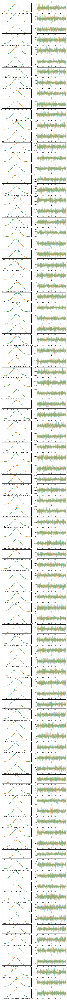

In [14]:
az.rcParams['plot.max_subplots'] = 2*(num_timepoints - R_t_start)

az.plot_trace(
    samples,
    var_names=('R'),
    filter_vars='like',
    compact=False)

In [15]:
# Eliminate burn-in iterations (1/2 of the chain lengths)
chain_samples = fit.draws()[500:, :, 7:]

# Evaluate the model for all parameter sets in the samples
n_param, n_sample, n_chains = chain_samples.shape

extended_samples = np.concatenate((
    chain_samples[:, 0, :],
    chain_samples[:, 1, :],
    chain_samples[:, 2, :]), axis=0)

thinning = max(1, int(n_sample * n_chains / 500))
approx_multicat_intervals = []

for j in range(num_categories):
    approx_multicat_intervals.append(pd.DataFrame({
        'Time Points': np.arange(R_t_start, num_timepoints),
        'Mean': np.mean(correc_i[j] * extended_samples[::thinning, :], axis=0),
        'Lower bound CI': np.quantile(correc_i[j] * extended_samples[::thinning, :], 0.025, axis=0),
        'Upper bound CI': np.quantile(correc_i[j] * extended_samples[::thinning, :], 0.975, axis=0),
        'Central Probability': (L1+L2+L3) * [0.95]
    }))

## 3. Average Contact data + Total cases + Poisson Branching process with multiple categories

In [16]:
agg_multicat_model = CmdStanModel(stan_file=os.path.join(
        '../../stan_models/agg_multicat.stan'))

agg_multicat_data = {
    'N': num_timepoints,
    'S': len(serial_interval),
    'n': num_categories,
    'C': contact_matrix,
    'transm': transmissibility,
    'I': agg_cases.astype(np.integer).tolist(),
    'tau': tau,
    'revSI': serial_interval.tolist()[::-1],
    'a': a,
    'b': b,
    'sigma': sigma}

/var/folders/ph/jyxnc9y52svgq2k5lt2q4r000000gp/T/ipykernel_27881/3052504579.py:10: DeprecationWarning:

Converting `np.integer` or `np.signedinteger` to a dtype is deprecated. The current result is `np.dtype(np.int_)` which is not strictly correct. Note that the result depends on the system. To ensure stable results use may want to use `np.int64` or `np.int32`.



In [17]:
fit = agg_multicat_model.sample(data=agg_multicat_data, seed=10, chains=3, iter_sampling=1000)

samples = az.from_cmdstanpy(fit)

az.summary(samples)

12:13:55 - cmdstanpy - INFO - CmdStan start processing
chain 1 |          | 00:00 Status

chain 1 |▉         | 29:16 Iteration:    1 / 2000 [  0%]  (Warmup)

chain 1 |█▎        | 32:03 Iteration:  100 / 2000 [  5%]  (Warmup)
chain 1 |█▊        | 34:25 Iteration:  200 / 2000 [ 10%]  (Warmup)
chain 1 |██▎       | 36:19 Iteration:  300 / 2000 [ 15%]  (Warmup)
chain 1 |██▋       | 38:40 Iteration:  400 / 2000 [ 20%]  (Warmup)
chain 1 |███▏      | 40:30 Iteration:  500 / 2000 [ 25%]  (Warmup)
chain 1 |███▋      | 42:01 Iteration:  600 / 2000 [ 30%]  (Warmup)
chain 1 |████      | 43:38 Iteration:  700 / 2000 [ 35%]  (Warmup)
chain 1 |████▌     | 45:13 Iteration:  800 / 2000 [ 40%]  (Warmup)

chain 1 |█████▍    | 47:04 Iteration: 1000 / 2000 [ 50%]  (Warmup)
chain 1 |█████▉    | 48:54 Iteration: 1001 / 2000 [ 50%]  (Sampling)
chain 1 |██████▎   | 50:45 Iteration: 1100 / 2000 [ 55%]  (Sampling)
chain 1 |██████▊   | 52:35 Iteration: 1200 / 2000 [ 60%]  (Sampling)
chain 1 |███████▎  | 54:22 Iter


13:18:44 - cmdstanpy - INFO - CmdStan done processing.
13:18:44 - cmdstanpy - WARNING - Non-fatal error during sampling:
Exception: gamma_lpdf: Random variable is 0, but must be positive finite! (in 'agg_multicat.stan', line 58, column 8 to column 28)
	Exception: gamma_lpdf: Random variable is 0, but must be positive finite! (in 'agg_multicat.stan', line 58, column 8 to column 28)
	Exception: gamma_lpdf: Random variable is 0, but must be positive finite! (in 'agg_multicat.stan', line 58, column 8 to column 28)
	Exception: gamma_lpdf: Random variable is 0, but must be positive finite! (in 'agg_multicat.stan', line 58, column 8 to column 28)
	Exception: gamma_lpdf: Random variable is 0, but must be positive finite! (in 'agg_multicat.stan', line 58, column 8 to column 28)
	Exception: gamma_lpdf: Random variable is 0, but must be positive finite! (in 'agg_multicat.stan', line 58, column 8 to column 28)
Exception: gamma_lpdf: Random variable is 0, but must be positive finite! (in 'agg_mult

,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_bulk,ess_tail,r_hat
R[0],0.659,0.049,0.573,0.752,0.001,0.001,4333.0,1974.0,1.0
R[1],0.638,0.041,0.557,0.713,0.001,0.000,4653.0,2086.0,1.0
R[2],0.585,0.035,0.522,0.652,0.001,0.000,4112.0,2396.0,1.0
R[3],0.549,0.031,0.493,0.610,0.001,0.000,3289.0,2185.0,1.0
R[4],0.498,0.027,0.446,0.547,0.000,0.000,3288.0,2285.0,1.0
...,...,...,...,...,...,...,...,...,...
"p[97, 1]",0.530,0.290,0.047,0.981,0.004,0.003,6395.0,1940.0,1.0
"p[98, 0]",0.504,0.291,0.056,0.999,0.004,0.003,4738.0,1489.0,1.0
"p[98, 1]",0.496,0.291,0.001,0.944,0.004,0.003,4737.0,1489.0,1.0
"p[99, 0]",0.500,0.288,0.017,0.959,0.004,0.003,6335.0,1555.0,1.0


array([[<Axes: title={'center': 'R\n0'}>,
        <Axes: title={'center': 'R\n0'}>],
       [<Axes: title={'center': 'R\n1'}>,
        <Axes: title={'center': 'R\n1'}>],
       [<Axes: title={'center': 'R\n2'}>,
        <Axes: title={'center': 'R\n2'}>],
       [<Axes: title={'center': 'R\n3'}>,
        <Axes: title={'center': 'R\n3'}>],
       [<Axes: title={'center': 'R\n4'}>,
        <Axes: title={'center': 'R\n4'}>],
       [<Axes: title={'center': 'R\n5'}>,
        <Axes: title={'center': 'R\n5'}>],
       [<Axes: title={'center': 'R\n6'}>,
        <Axes: title={'center': 'R\n6'}>],
       [<Axes: title={'center': 'R\n7'}>,
        <Axes: title={'center': 'R\n7'}>],
       [<Axes: title={'center': 'R\n8'}>,
        <Axes: title={'center': 'R\n8'}>],
       [<Axes: title={'center': 'R\n9'}>,
        <Axes: title={'center': 'R\n9'}>],
       [<Axes: title={'center': 'R\n10'}>,
        <Axes: title={'center': 'R\n10'}>],
       [<Axes: title={'center': 'R\n11'}>,
        <Axes: title

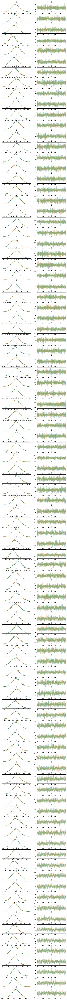

In [18]:
az.rcParams['plot.max_subplots'] = 2*(num_timepoints - R_t_start)

az.plot_trace(
    samples,
    var_names=('R'),
    filter_vars='like',
    compact=False)

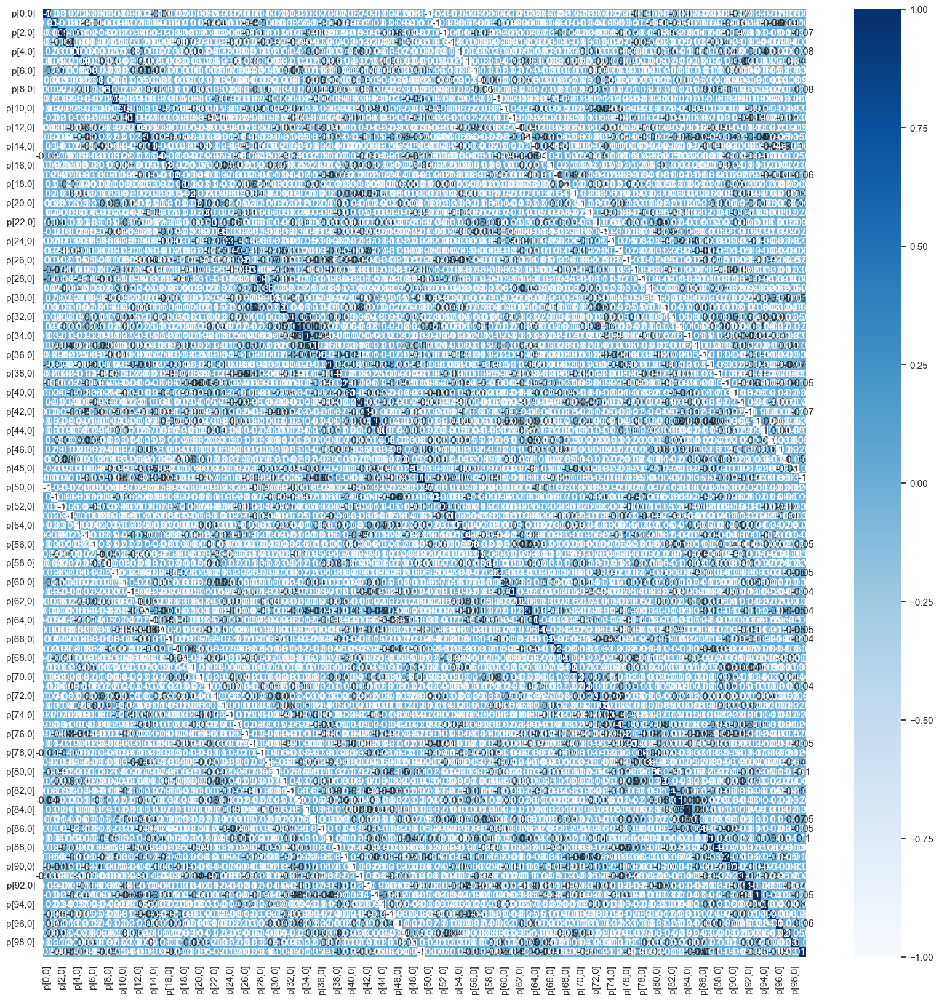

In [19]:
# Eliminate burn-in iterations (1/2 of the chain lengths)
p_chain_samples = fit.draws()[500:, :, (num_timepoints - R_t_start +7)::num_categories]

# Evaluate the model for all parameter sets in the samples
n_param, n_sample, n_chains = p_chain_samples.shape

extended_p_samples = np.concatenate((
    p_chain_samples[:, 0, :],
    p_chain_samples[:, 1, :],
    p_chain_samples[:, 2, :]), axis=0)

df = pd.DataFrame(
    extended_p_samples,
    columns=[
        'p[{},0]'.format(_)
        for _ in range(num_timepoints)])

plt.figure(figsize=(20,20))
sns.set_theme(style="white")
corr = df.corr()
heatmap = sns.heatmap(corr, annot=True, cmap="Blues", fmt='.1g')

In [20]:
# Eliminate burn-in iterations (1/2 of the chain lengths)
chain_samples = fit.draws()[500:, :, 7:(num_timepoints - R_t_start +7)]

# Evaluate the model for all parameter sets in the samples
n_param, n_sample, n_chains = chain_samples.shape

extended_samples = np.concatenate((
    chain_samples[:, 0, :],
    chain_samples[:, 1, :],
    chain_samples[:, 2, :]), axis=0)

thinning = max(1, int(n_sample * n_chains / 500))
agg_multicat_intervals = []

for j in range(num_categories):
    agg_multicat_intervals.append(pd.DataFrame({
        'Time Points': np.arange(R_t_start, num_timepoints),
        'Mean': np.mean(correc_i[j] * extended_samples[::thinning, :], axis=0),
        'Lower bound CI': np.quantile(correc_i[j] * extended_samples[::thinning, :], 0.025, axis=0),
        'Upper bound CI': np.quantile(correc_i[j] * extended_samples[::thinning, :], 0.975, axis=0),
        'Central Probability': (L1+L2+L3) * [0.95]
    }))

## 4. No Contact data + Total cases + Poisson Branching process

In [21]:
poisson_model = CmdStanModel(stan_file=os.path.join(
        '../../stan_models/poisson_one.stan'))

poisson_data = {
    'N': num_timepoints,
    'S': len(serial_interval),
    'I': agg_cases.astype(np.integer).tolist(),
    'tau': tau,
    'revSI': serial_interval.tolist()[::-1],
    'a': a,
    'b': b,
    'sigma': sigma}

/var/folders/ph/jyxnc9y52svgq2k5lt2q4r000000gp/T/ipykernel_27881/3414372969.py:7: DeprecationWarning:

Converting `np.integer` or `np.signedinteger` to a dtype is deprecated. The current result is `np.dtype(np.int_)` which is not strictly correct. Note that the result depends on the system. To ensure stable results use may want to use `np.int64` or `np.int32`.



In [22]:
fit = poisson_model.sample(
    data=poisson_data, seed=10, chains=3, iter_sampling=1000)

samples = az.from_cmdstanpy(fit)

az.summary(samples)

13:19:09 - cmdstanpy - INFO - CmdStan start processing
chain 1 |          | 00:00 Status
chain 1 |▍         | 00:00 Status

chain 1 |▉         | 00:01 Iteration:    1 / 2000 [  0%]  (Warmup)
chain 1 |█▎        | 00:02 Iteration:  100 / 2000 [  5%]  (Warmup)
chain 1 |█▊        | 00:03 Iteration:  200 / 2000 [ 10%]  (Warmup)
chain 1 |██▎       | 00:04 Iteration:  300 / 2000 [ 15%]  (Warmup)
chain 1 |██▋       | 00:05 Iteration:  400 / 2000 [ 20%]  (Warmup)
chain 1 |███▏      | 00:06 Iteration:  500 / 2000 [ 25%]  (Warmup)
chain 1 |███▋      | 00:07 Iteration:  600 / 2000 [ 30%]  (Warmup)
chain 1 |████      | 00:07 Iteration:  700 / 2000 [ 35%]  (Warmup)
chain 1 |█████     | 00:09 Iteration:  900 / 2000 [ 45%]  (Warmup)
chain 1 |█████▉    | 00:10 Iteration: 1001 / 2000 [ 50%]  (Sampling)
chain 1 |██████▎   | 00:10 Iteration: 1100 / 2000 [ 55%]  (Sampling)
chain 1 |██████▊   | 00:11 Iteration: 1200 / 2000 [ 60%]  (Sampling)
chain 1 |███████▎  | 00:12 Iteration: 1300 / 2000 [ 65%]  (Samplin


13:19:31 - cmdstanpy - INFO - CmdStan done processing.
13:19:31 - cmdstanpy - WARNING - Non-fatal error during sampling:
Exception: gamma_lpdf: Random variable is inf, but must be positive finite! (in 'poisson_one.stan', line 45, column 8 to column 28)
	Exception: gamma_lpdf: Random variable is inf, but must be positive finite! (in 'poisson_one.stan', line 45, column 8 to column 28)
	Exception: gamma_lpdf: Random variable is 0, but must be positive finite! (in 'poisson_one.stan', line 45, column 8 to column 28)
	Exception: gamma_lpdf: Random variable is inf, but must be positive finite! (in 'poisson_one.stan', line 45, column 8 to column 28)
	Exception: gamma_lpdf: Random variable is inf, but must be positive finite! (in 'poisson_one.stan', line 45, column 8 to column 28)
Exception: gamma_lpdf: Random variable is inf, but must be positive finite! (in 'poisson_one.stan', line 45, column 8 to column 28)
	Exception: gamma_lpdf: Random variable is inf, but must be positive finite! (in 'po

,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_bulk,ess_tail,r_hat
R[0],5.800,0.412,5.067,6.621,0.006,0.004,4319.0,1999.0,1.0
R[1],5.569,0.350,4.925,6.222,0.005,0.003,5385.0,2094.0,1.0
R[2],5.071,0.280,4.562,5.635,0.004,0.003,4975.0,2316.0,1.0
R[3],4.708,0.256,4.207,5.176,0.004,0.003,5239.0,2219.0,1.0
R[4],4.229,0.205,3.861,4.620,0.003,0.002,3899.0,2125.0,1.0
...,...,...,...,...,...,...,...,...,...
R[88],1.751,0.033,1.694,1.818,0.000,0.000,4746.0,2202.0,1.0
R[89],1.744,0.030,1.689,1.804,0.000,0.000,4686.0,1787.0,1.0
R[90],1.589,0.029,1.535,1.643,0.000,0.000,4528.0,2199.0,1.0
R[91],1.428,0.027,1.378,1.479,0.000,0.000,4639.0,2132.0,1.0


array([[<Axes: title={'center': 'R\n0'}>,
        <Axes: title={'center': 'R\n0'}>],
       [<Axes: title={'center': 'R\n1'}>,
        <Axes: title={'center': 'R\n1'}>],
       [<Axes: title={'center': 'R\n2'}>,
        <Axes: title={'center': 'R\n2'}>],
       [<Axes: title={'center': 'R\n3'}>,
        <Axes: title={'center': 'R\n3'}>],
       [<Axes: title={'center': 'R\n4'}>,
        <Axes: title={'center': 'R\n4'}>],
       [<Axes: title={'center': 'R\n5'}>,
        <Axes: title={'center': 'R\n5'}>],
       [<Axes: title={'center': 'R\n6'}>,
        <Axes: title={'center': 'R\n6'}>],
       [<Axes: title={'center': 'R\n7'}>,
        <Axes: title={'center': 'R\n7'}>],
       [<Axes: title={'center': 'R\n8'}>,
        <Axes: title={'center': 'R\n8'}>],
       [<Axes: title={'center': 'R\n9'}>,
        <Axes: title={'center': 'R\n9'}>],
       [<Axes: title={'center': 'R\n10'}>,
        <Axes: title={'center': 'R\n10'}>],
       [<Axes: title={'center': 'R\n11'}>,
        <Axes: title

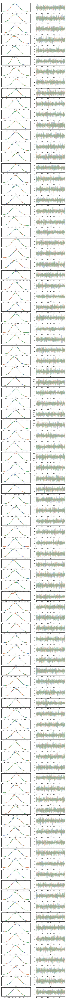

In [23]:
az.rcParams['plot.max_subplots'] = 2*(num_timepoints - R_t_start)

az.plot_trace(
    samples,
    var_names=('R'),
    filter_vars='like',
    compact=False)

In [24]:
# Eliminate burn-in iterations (1/2 of the chain lengths)
chain_samples = fit.draws()[500:, :, 7:]

# Evaluate the model for all parameter sets in the samples
n_param, n_sample, n_chains = chain_samples.shape

extended_samples = np.concatenate((
    chain_samples[:, 0, :],
    chain_samples[:, 1, :],
    chain_samples[:, 2, :]), axis=0)

thinning = max(1, int(n_sample * n_chains / 500))

pois_intervals = pd.DataFrame({
    'Time Points': np.arange(R_t_start, num_timepoints),
    'Mean': np.mean(extended_samples[::thinning, :], axis=0),
    'Lower bound CI': np.quantile(extended_samples[::thinning, :], 0.025, axis=0),
    'Upper bound CI': np.quantile(extended_samples[::thinning, :], 0.975, axis=0),
    'Central Probability': (L1+L2+L3) * [0.95]
})

## Inference plot using class method results

In [46]:
fig = ReproductionNumberPlot()

j=0
fig.add_ground_truth_rt(ground_truth[j])
fig.figure.data[0]['name'] = 'True R<sup>({})</sup><sub>t</sub>'.format(j+1)

fig.add_interval_rt(approx_multicat_intervals[j], colour='red', model_type='<sup>({})</sup><sub>t</sub> Group-specific cases + Average C<sub>t</sub> data Multiple-group model'.format(j+1))
fig.figure.data[1]['name'] = 'Estimated R<sup>({})</sup><sub>t</sub> Group-specific cases + Average C<sub>t</sub> data<br>Multiple-group model'.format(j+1)

fig.add_interval_rt(agg_multicat_intervals[j], colour='orange', model_type='<sup>({})</sup><sub>t</sub> Total cases + Average C<sub>t</sub> data Multiple-group model'.format(j+1))
fig.figure.data[3]['name'] = 'Estimated R<sup>({})</sup><sub>t</sub> Total cases + Average C<sub>t</sub> data<br>Multiple-group model'.format(j+1)

fig.add_interval_rt(pois_intervals, colour='deepskyblue', model_type='One-group model')
fig.figure.data[5]['name'] = 'Estimated R<sub>t</sub> One-group model'
   
fig.update_labels(time_label='Time (days)', r_label='Reproduction number R<sub>t</sub>')

for i in range(3):
        fig.figure['data'][2*(i+1)]['showlegend'] = False

fig.figure.add_hline(
    y=1, line_dash='dot',
    annotation_text='R<sub>t</sub>=1', fillcolor='black',
    annotation_position='bottom left')

fig.figure.update_layout(
    width=900, 
    height=600,
    plot_bgcolor='white',
    font=dict(
            size=16),
    xaxis=dict(
        linecolor='black'),
    yaxis=dict(
        linecolor='black'),
    legend=dict(
            orientation="h",
            yanchor="bottom",
            y=0.65,
            xanchor="right",
            x=1.05,
            bordercolor="Black",
            borderwidth=1,
            itemwidth=50
        )
)

fig.figure.write_image('images/Figure 3.pdf')

fig.show_figure()

In [47]:
fig = ReproductionNumberPlot()

j=0
fig.add_ground_truth_rt(ground_truth[j])
fig.figure.data[0]['name'] = 'True R<sup>({})</sup><sub>t</sub>'.format(j+1)

fig.add_interval_rt(exact_multicat_intervals[j], colour='mediumvioletred', model_type='<sup>({})</sup><sub>t</sub> Exact C<sub>t</sub> data Multiple-group model'.format(j+1))
fig.figure.data[1]['name'] = 'Estimated R<sup>({})</sup><sub>t</sub> Exact C<sub>t</sub> data Multiple-group model'.format(j+1)

fig.add_interval_rt(pois_intervals, colour='deepskyblue', model_type='One-group model')
fig.figure.data[3]['name'] = 'Estimated R<sub>t</sub> One-group model'
   
fig.update_labels(time_label='Time (days)', r_label='Reproduction number R<sub>t</sub>')

for i in range(2):
        fig.figure['data'][2*(i+1)]['showlegend'] = False

fig.figure.add_hline(
    y=1, line_dash='dot',
    annotation_text='R<sub>t</sub>=1', fillcolor='black',
    annotation_position='bottom left')

fig.figure.update_layout(
    width=900, 
    height=600,
    plot_bgcolor='white',
    font=dict(
            size=16),
    xaxis=dict(
        linecolor='black'),
    yaxis=dict(
        linecolor='black'),
    legend=dict(
            orientation="h",
            yanchor="bottom",
            y=0.8,
            xanchor="right",
            x=1.05,
            bordercolor="Black",
            borderwidth=1
        )
)

fig.figure.write_image('images/Figure 3 Perfect.pdf')

fig.show_figure()

In [48]:
fig = ReproductionNumberPlot()

j=1
fig.add_ground_truth_rt(ground_truth[j])
fig.figure.data[0]['name'] = 'True R<sup>({})</sup><sub>t</sub>'.format(j+1)

fig.add_interval_rt(approx_multicat_intervals[j], colour='red', model_type='<sup>({})</sup><sub>t</sub> Group-specific cases + Average C<sub>t</sub> data Multiple-group model'.format(j+1))
fig.figure.data[1]['name'] = 'Estimated R<sup>({})</sup><sub>t</sub> Group-specific cases + Average C<sub>t</sub> data<br>Multiple-group model'.format(j+1)

fig.add_interval_rt(agg_multicat_intervals[j], colour='orange', model_type='<sup>({})</sup><sub>t</sub> Total cases + Average C<sub>t</sub> data Multiple-group model'.format(j+1))
fig.figure.data[3]['name'] = 'Estimated R<sup>({})</sup><sub>t</sub> Total cases + Average C<sub>t</sub> data<br>Multiple-group model'.format(j+1)

fig.add_interval_rt(pois_intervals, colour='deepskyblue', model_type='One-group model')
fig.figure.data[5]['name'] = 'Estimated R<sub>t</sub> One-group model'

fig.update_labels(time_label='Time (days)', r_label='Reproduction number R<sub>t</sub>')

for i in range(3):
        fig.figure['data'][2*(i+1)]['showlegend'] = False

fig.figure.add_hline(
    y=1, line_dash='dot',
    annotation_text='R<sub>t</sub>=1', fillcolor='black',
    annotation_position='bottom left')

fig.figure.update_layout(
    width=900, 
    height=600,
    plot_bgcolor='white',
    font=dict(
            size=16),
    xaxis=dict(
        linecolor='black'),
    yaxis=dict(
        linecolor='black'),
    legend=dict(
            orientation="h",
            yanchor="bottom",
            y=0.65,
            xanchor="right",
            x=1.05,
            bordercolor="Black",
            borderwidth=1
        )
)

fig.figure.write_image('images/Figure 4.pdf')

fig.show_figure()

In [49]:
fig = ReproductionNumberPlot()

j=1
fig.add_ground_truth_rt(ground_truth[j])
fig.figure.data[0]['name'] = 'True R<sup>({})</sup><sub>t</sub>'.format(j+1)

fig.add_interval_rt(exact_multicat_intervals[j], colour='mediumvioletred', model_type='<sup>({})</sup><sub>t</sub> Exact C<sub>t</sub> data Multiple-group model'.format(j+1))
fig.figure.data[1]['name'] = 'Estimated R<sup>({})</sup><sub>t</sub> Exact C<sub>t</sub> data Multiple-group model'.format(j+1)

fig.add_interval_rt(pois_intervals, colour='deepskyblue', model_type='One-group model')
fig.figure.data[3]['name'] = 'Estimated R<sub>t</sub> One-group model'

fig.update_labels(time_label='Time (days)', r_label='Reproduction number R<sub>t</sub>')

for i in range(2):
        fig.figure['data'][2*(i+1)]['showlegend'] = False

fig.figure.add_hline(
    y=1, line_dash='dot',
    annotation_text='R<sub>t</sub>=1', fillcolor='black',
    annotation_position='bottom left')

fig.figure.update_layout(
    width=900, 
    height=600,
    plot_bgcolor='white',
    font=dict(
            size=16),
    xaxis=dict(
        linecolor='black'),
    yaxis=dict(
        linecolor='black'),
    legend=dict(
            orientation="h",
            yanchor="bottom",
            y=0.8,
            xanchor="right",
            x=1.05,
            bordercolor="Black",
            borderwidth=1
        )
)

fig.figure.write_image('images/Figure 4 Perfect.pdf')

fig.show_figure()